In [1]:
# Lertas Giorgos 

# import libraries
import pandas as pd
import numpy as np
import os 
import math
import matplotlib.pyplot as plt
import seaborn as sns

from platform import python_version
python_version()

'3.8.13'

### 1. Upload data

In [2]:
path = '/Users/giorgoslertas/Desktop/Lertas_files/data_science/Thesis/ddi_pred'   # add my path, where are the files
os.chdir(path)    # os.getcwd() current working file

# read file with interractions and remove column with side effect polypharmacy code, because we have the names
combo = pd.read_csv('data/bio-decagon-combo.csv')   # 4 columns (drug - drug - inter_codes - inter_names)
combo2 = combo.drop('Polypharmacy Side Effect', axis=1)   # 3 columns (drug - drug - inter_names)

# Also, replace blank spaces, in names, with underscore
combo2['Side Effect Name'] = combo2['Side Effect Name'].str.replace(' ','_')

# 4649441 rows × 3 columns


# read files with names, that export with the code in cmd from dgl-ke
entities = pd.read_csv('dgl-ke/entities.tsv', names = ['names'], index_col=None)   # 645 drug names
relations = pd.read_csv('dgl-ke/relations.tsv', names = ['names'], index_col=None)    # 1317 relation names

# read files with embeddings, that export with the code in cmd from dgl-ke
entities_emb = np.load('ckpts/TransE_ddi_pr_0/ddi_pr_TransE_entity.npy')   # (645, 400)
relations_emb = np.load('ckpts/TransE_ddi_pr_0/ddi_pr_TransE_relation.npy')   # (1317, 400)


# Create task with sub-categories

# read file with sub-categories of side effect names
effectcategories=pd.read_csv('data/bio-decagon-effectcategories.csv')   # 561 rows × 3 columns

# Also, replace blank spaces, in names, with underscore
effectcategories['Side Effect Name'] = effectcategories['Side Effect Name'].str.replace(' ','_')
effectcategories['Disease Class'] = effectcategories['Disease Class'].str.replace(' ','_')
effectcategories = effectcategories.drop('Side Effect', axis=1)   # 561 rows × 2 columns

# create df with disease classes sorted by based on which ones appear the most
dis_sort = pd.DataFrame(effectcategories['Disease Class'].value_counts().head(15)).reset_index()
dis_sort.columns = ['Disease Class', 'counts']

# create df with Side Effect Name per Disease Class for first 15 disease classes   494 rows × 2 columns
classes = effectcategories[effectcategories['Disease Class'].isin(dis_sort['Disease Class'].values)]

# create df with Disease Class per Side Effect Name as drug-drug interractions    1512400 rows × 4 columns
new_data = pd.merge(classes, combo2, on=['Side Effect Name'])

### 2. Create X

In [3]:
# function to create X values 
def export_X(X):
    
    # for each drug, add embeddings from the exported file of dgl-ke
    x1 = [entities_emb[entities[entities.names == i].index] for i in X['STITCH 1']]
    x2 = [entities_emb[entities[entities.names == i].index] for i in X['STITCH 2']]
    
    # reshape all to 2d matrix
    x1 = np.reshape(x1, (len(x1), 400))
    x2 = np.reshape(x2, (len(x2), 400))
    
    # create X values with concatenation of 2 files with interracted drugs
    x = [np.concatenate([sub1,sub2]) for sub1, sub2 in zip(x1, x2)]
    x = pd.DataFrame(np.transpose(x))
    
    return x

In [4]:
# number of unique drug-drug interractions            62798 rows × 2 columns
unique = new_data[['STITCH 1','STITCH 2']].drop_duplicates()

X = export_X(unique)   # 800 rows × 62798 columns

### 3. Create S

In [5]:
# read file with biobert embeddings
bio_embs = pd.read_csv('bio_embeddings/embeddings.csv')

# Also, replace blank spaces, in names, with underscore
bio_embs['relations'] = bio_embs['relations'].str.replace(' ','_')

# collect only the relations that we use and transpose them because of  S ∈ a×z
S = bio_embs[bio_embs['relations'].isin(classes['Side Effect Name'])].T

# beacause 1st row has relation names, we use loc to take them and add them as col names
S.columns = S.loc['relations'].values
S = S.drop(index=('relations'))   # drop the row with names     768 rows × 494 columns

In [6]:
# take some sub-classes to add them as unseen
unseen_subclasses = dis_sort['Disease Class'].tail(2)

# create a list from new_data 
unseen_cols = new_data[new_data['Disease Class'].isin(unseen_subclasses)]['Side Effect Name'].unique()

# create seen and unseen data from S dataframe
S_unseen = S[unseen_cols]   # (768, x)  x -> lenght_of_unseen_cols values
S_seen = S.drop(unseen_cols, axis = 1)   # (768, y)  y-> all classes (494) minus length_of_unseen_cols values

### 4. Create Y

In [7]:
# read file with hot encoding in interractions per drug drug couple
df_Y = pd.read_csv('side_effect_dummies/Y_dummies.csv')    # 63473 rows × 1319 columns

# merge 2 dataframe based on unique df, which has only the interractions that we wil use
df_Y = pd.merge(unique, df_Y, on=['STITCH 1','STITCH 2'])   # 62798 rows × 1319 columns

# remove columns with drugs, then replace spaces in column names and keep only S column names
Y = df_Y.drop(['STITCH 1', 'STITCH 2'], axis=1)
Y.columns = Y.columns.str.replace(' ','_')
Y = Y[S.columns]    # 62798 rows × 494 columns

### 5. Create Y & Y΄ and X & X΄

In [8]:
# in Y dataframe, we search only in unseen columns where we have rows with values not equal to 0
# so use T (transpose) to search column by column
absent_indices = Y[(Y[unseen_cols].T != 0).any()].index

Y_unseen = Y.iloc[absent_indices][unseen_cols]
X_unseen = X[absent_indices]
Y_seen = Y.drop(absent_indices, axis=0).drop(unseen_cols, axis=1)
X_seen = X.drop(absent_indices, axis=1)

### 6. function for V

In [9]:
# function to calculate V values
def calculate_V(X,Y,S,gamma=1,lamda=1):
    
    # create I table with len(X) dimensions. I table has on the diagonal of the ace and the other numbers are 0
    I = np.eye(len(X))
    part_1 = np.linalg.inv((X.dot(X.T)+gamma*I))

    # fix columns be in same row as Y columns
    S = S[Y.columns].astype(float)
    part_2 = X.dot(Y).dot(S.T)
    
    # create I table with len(S) dimensions. I table has on the diagonal of the ace and the other numbers are 0
    I = np.eye(len(S))
    part_3 = np.linalg.inv((S.dot(S.T)+lamda*I))
    
    # calculate V
    V = part_1.dot(part_2).dot(part_3)
    V = pd.DataFrame(V)
    
    return V

In [10]:
# W = V * S.T, where V ∈ R(d×a) (d=800(dd_emb->400*2), a=768(biobert embeddings))

# calculate V only in unseen classes
V = calculate_V(X_seen,Y_seen,S_seen)    # V -> shape  800 rows × 768 columns

### 7. Stats

In [11]:
from sklearn.metrics.pairwise import cosine_similarity

cosine = pd.DataFrame(cosine_similarity(S.T))
cosine.columns = S.columns
cosine.index = S.columns
cosine

,retinopathy_of_prematurity,lung_edema,peliosis,allergies,thrombocytopenia,hyperglycaemia,hypoglycaemia,asystole,cerebral_infarct,adynamic_ileus,...,hemophilia_B,erythremia,chorioretinitis,rickets,Vasomotor_Rhinitis,corneal_degeneration,Acromegaly,bladder_diverticulum,Rubella,rabies
retinopathy_of_prematurity,1.000000,0.732391,0.725874,0.687116,0.749551,0.766919,0.776113,0.689519,0.748093,0.761158,...,0.776740,0.727701,0.839272,0.745860,0.771467,0.823312,0.754070,0.726146,0.664521,0.718967
lung_edema,0.732391,1.000000,0.796231,0.724344,0.765098,0.796226,0.775739,0.731144,0.829579,0.801590,...,0.759800,0.800905,0.771199,0.813563,0.719644,0.800980,0.775781,0.776758,0.742588,0.766860
peliosis,0.725874,0.796231,1.000000,0.695401,0.742601,0.774729,0.754505,0.707865,0.741921,0.849704,...,0.854148,0.833934,0.806829,0.847652,0.724199,0.780986,0.815645,0.787281,0.847136,0.832134
allergies,0.687116,0.724344,0.695401,1.000000,0.706667,0.725213,0.723627,0.688432,0.656984,0.741569,...,0.725550,0.691219,0.718634,0.746437,0.830425,0.718893,0.758202,0.699799,0.671209,0.742945
thrombocytopenia,0.749551,0.765098,0.742601,0.706667,1.000000,0.775059,0.792198,0.711572,0.731475,0.752213,...,0.854272,0.839614,0.758288,0.747268,0.728522,0.754357,0.768440,0.725985,0.659866,0.695909
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
corneal_degeneration,0.823312,0.800980,0.780986,0.718893,0.754357,0.804972,0.797959,0.719161,0.794954,0.797709,...,0.781647,0.773303,0.895607,0.774620,0.790872,1.000000,0.795872,0.804911,0.708734,0.750944
Acromegaly,0.754070,0.775781,0.815645,0.758202,0.768440,0.815270,0.802547,0.762741,0.760677,0.830440,...,0.808865,0.768081,0.797287,0.813424,0.807081,0.795872,1.000000,0.772580,0.728271,0.780116
bladder_diverticulum,0.726146,0.776758,0.787281,0.699799,0.725985,0.754088,0.726837,0.687916,0.779401,0.879267,...,0.760908,0.731297,0.786315,0.756361,0.725348,0.804911,0.772580,1.000000,0.705023,0.732990
Rubella,0.664521,0.742588,0.847136,0.671209,0.659866,0.703601,0.689958,0.668138,0.717692,0.751631,...,0.766018,0.761237,0.760871,0.823017,0.668966,0.708734,0.728271,0.705023,1.000000,0.841891


### 8. Evaluation

In [12]:
from sklearn.metrics import multilabel_confusion_matrix, classification_report, multilabel_confusion_matrix, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

def report(y_test, predictions, target):
    print('classification report:\n',classification_report(y_test,predictions, target_names=target, zero_division =0))
    
    # confusion matrix on heatmap
    matrix = multilabel_confusion_matrix(y_test,predictions)
    for i,j in enumerate(matrix):
        plt.figure(figsize=(10,7))
        sns.heatmap(j, annot=True,fmt="d",cmap='Blues')
        plt.ylabel('Actual label');
        plt.xlabel('Predicted label');
        title = f'Confusion Matrix with Accuracy Score: {accuracy_score(y_test.iloc[:,i],predictions.iloc[:,i])*100:.3f} %  for  {target[i]}'
        plt.title(title, size = 17);


In [13]:
# calculate the preds from the sample in hidden classes
train_unseen = X_unseen.T.dot(V).dot(S_unseen.values)
train_unseen.columns = Y_unseen.columns
train_unseen.shape

(38811, 28)

In [14]:
# calculate the preds from the sample
train_seen = X_seen.T.dot(V).dot(S_seen.values)
train_seen.columns = Y_seen.columns
train_seen.shape

(23987, 466)



Seen Data

classification report:
                                      precision    recall  f1-score   support

         retinopathy_of_prematurity       0.00      0.00      0.00        16
                         lung_edema       0.34      0.26      0.30      2567
                           peliosis       0.43      0.01      0.02       853
                          allergies       0.35      0.13      0.19      2467
                   thrombocytopenia       0.42      0.55      0.48      5519
                      hypoglycaemia       0.39      0.10      0.15      2061
                           asystole       0.35      0.46      0.39      3324
                   cerebral_infarct       0.50      0.15      0.23      1689
                     adynamic_ileus       0.47      0.01      0.02      1426
Acute_Respiratory_Distress_Syndrome       0.37      0.20      0.26      1532
                       appendicitis       0.00      0.00      0.00       152
             pulmonary_hypertension   

/var/folders/_r/rj5_2jss2pg_9qqz14jk9v080000gn/T/ipykernel_93740/1970730324.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,7))




UnSeen Data

classification report:
                                      precision    recall  f1-score   support

                            neuroma       0.00      0.00      0.00       433
                        haemangioma       0.00      0.00      0.00      1536
                             lipoma       0.17      0.00      0.00      9754
                           Diabetes       0.36      0.01      0.03     12718
                              myoma       0.00      0.00      0.00        13
                Glucose_intolerance       0.03      0.01      0.01      2107
                     colon_neoplasm       0.00      0.00      0.00       555
                     hyperuricaemia       0.14      0.00      0.00      3413
                  diabetic_acidosis       0.00      0.00      0.00      3523
                        amyloidosis       0.00      0.00      0.00       833
                laryngeal_neoplasia       0.00      0.00      0.00        33
            Blood_Calcium_Increased 

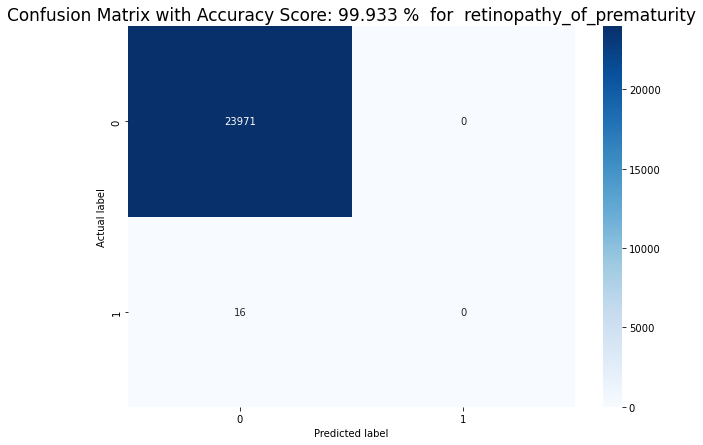

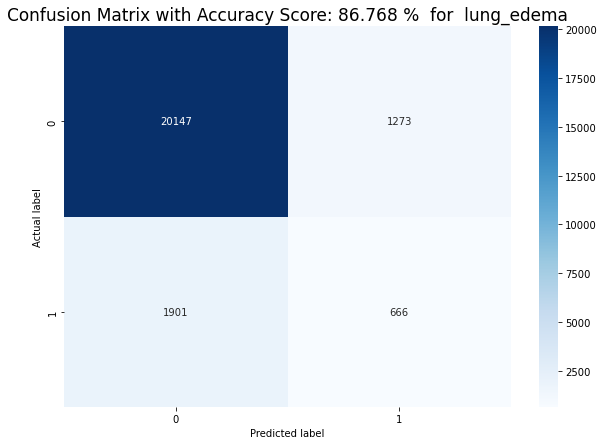

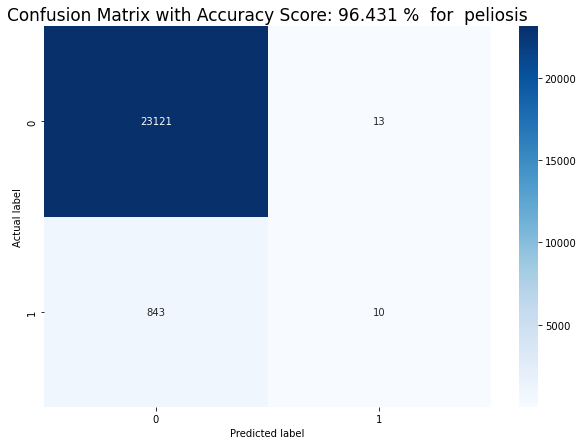

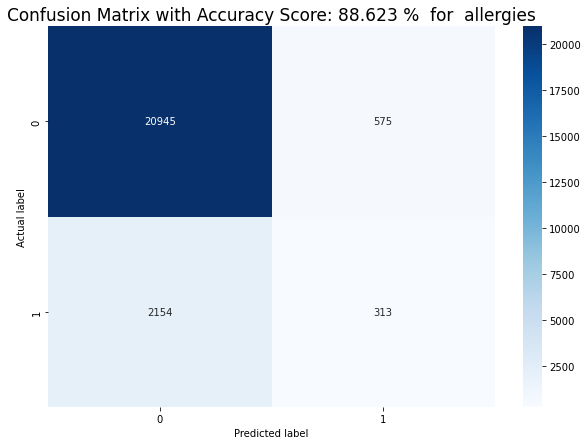

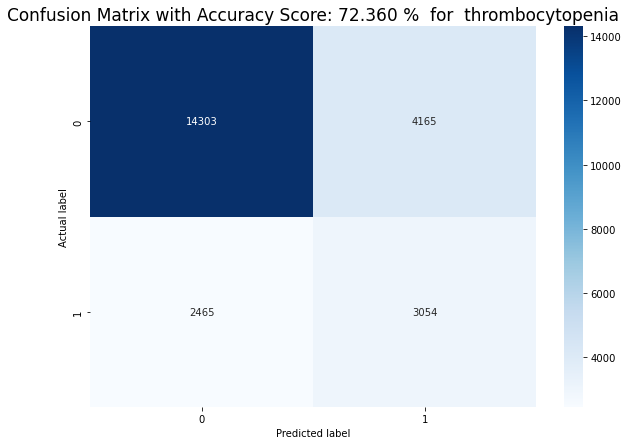

...

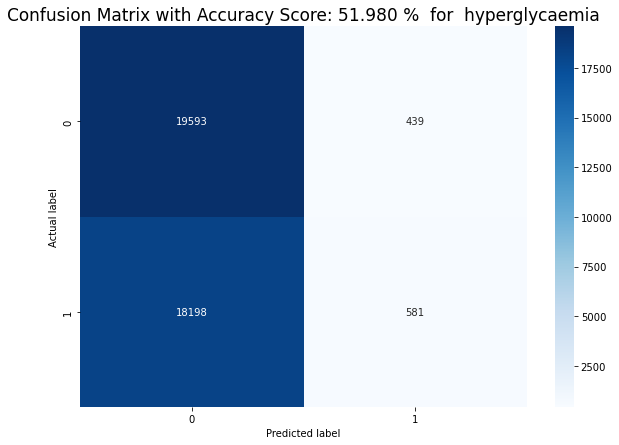

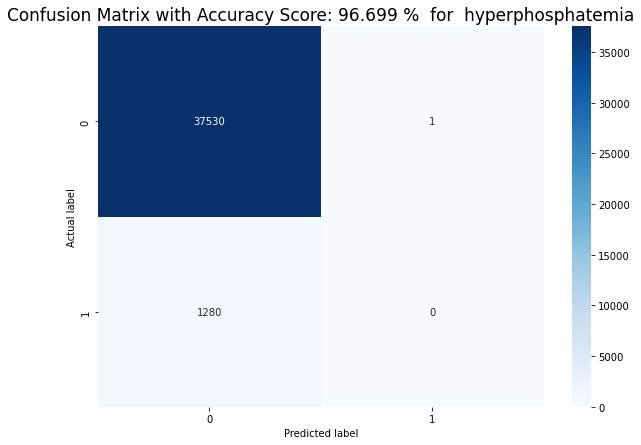

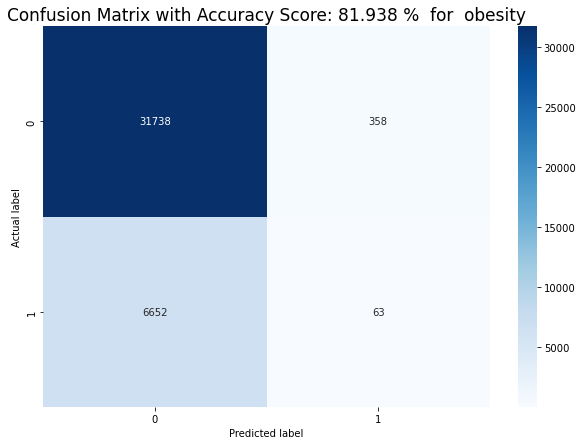

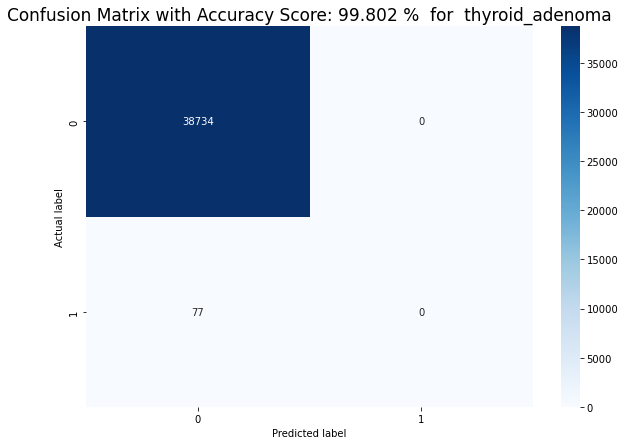

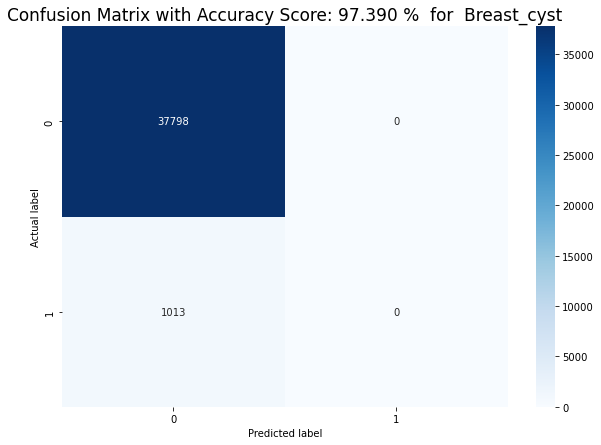

In [16]:
print('\n\nSeen Data\n')
preds_seen = (train_seen > 0.2).astype("int32")
report(Y_seen, preds_seen, list(preds_seen.columns))

print('\n\nUnSeen Data\n')
preds_unseen = (train_unseen > 0.2).astype("int32")
report(Y_unseen, preds_unseen, list(preds_unseen.columns))



Seen Data

classification report:
                                      precision    recall  f1-score   support

         retinopathy_of_prematurity       0.00      0.00      0.00        16
                         lung_edema       0.00      0.00      0.00      2567
                           peliosis       0.00      0.00      0.00       853
                          allergies       0.00      0.00      0.00      2467
                   thrombocytopenia       0.75      0.02      0.03      5519
                      hypoglycaemia       0.00      0.00      0.00      2061
                           asystole       0.79      0.01      0.01      3324
                   cerebral_infarct       0.00      0.00      0.00      1689
                     adynamic_ileus       0.00      0.00      0.00      1426
Acute_Respiratory_Distress_Syndrome       0.00      0.00      0.00      1532
                       appendicitis       0.00      0.00      0.00       152
             pulmonary_hypertension   

/var/folders/_r/rj5_2jss2pg_9qqz14jk9v080000gn/T/ipykernel_93740/1970730324.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,7))




UnSeen Data

classification report:
                                      precision    recall  f1-score   support

                            neuroma       0.00      0.00      0.00       433
                        haemangioma       0.00      0.00      0.00      1536
                             lipoma       0.00      0.00      0.00      9754
                           Diabetes       0.00      0.00      0.00     12718
                              myoma       0.00      0.00      0.00        13
                Glucose_intolerance       0.00      0.00      0.00      2107
                     colon_neoplasm       0.00      0.00      0.00       555
                     hyperuricaemia       0.00      0.00      0.00      3413
                  diabetic_acidosis       0.00      0.00      0.00      3523
                        amyloidosis       0.00      0.00      0.00       833
                laryngeal_neoplasia       0.00      0.00      0.00        33
            Blood_Calcium_Increased 

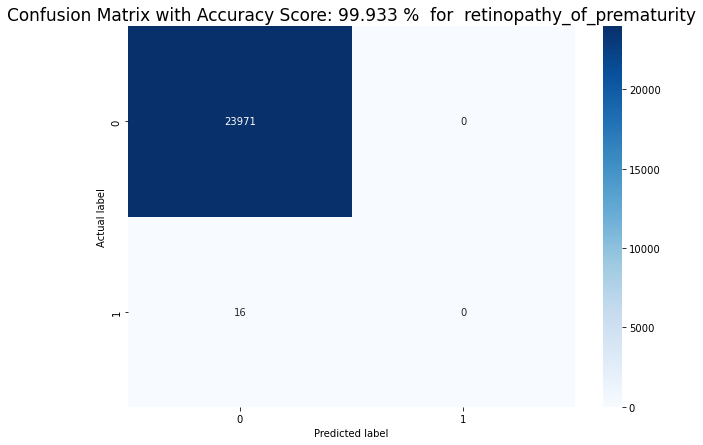

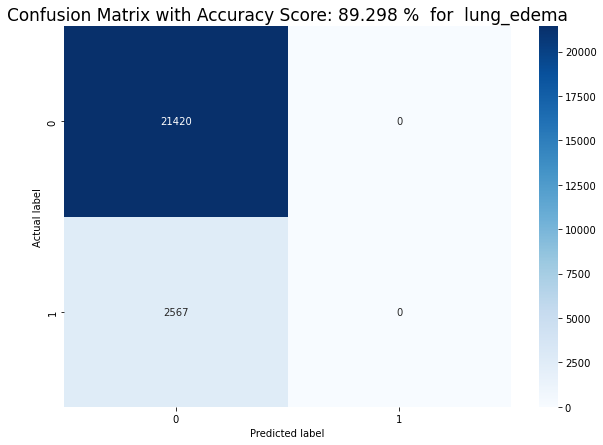

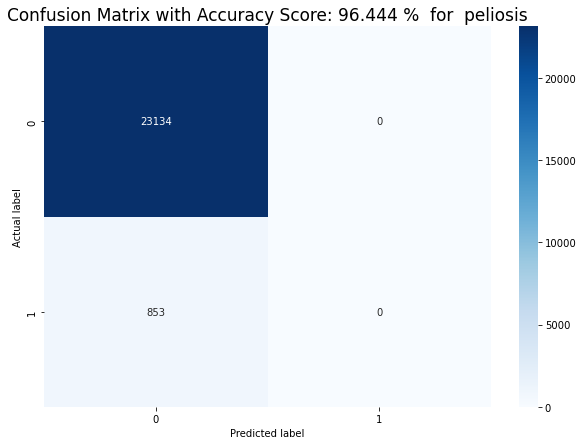

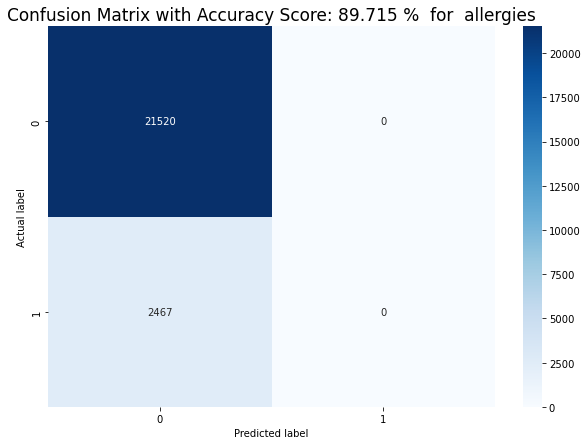

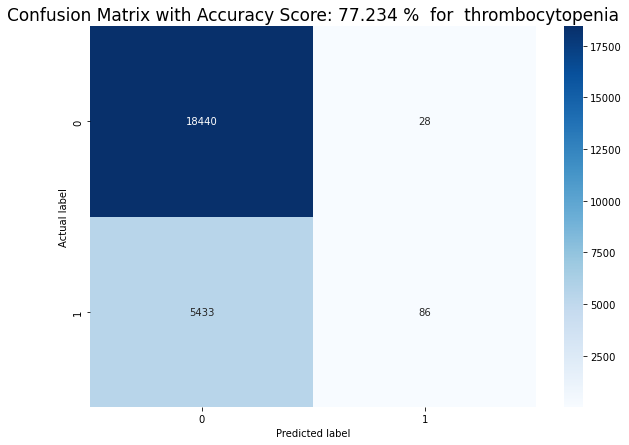

...

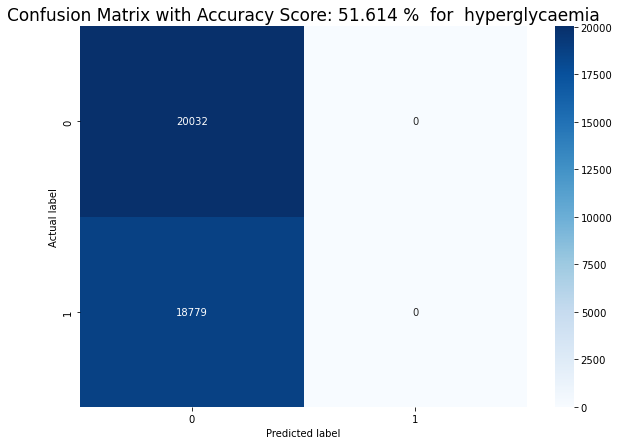

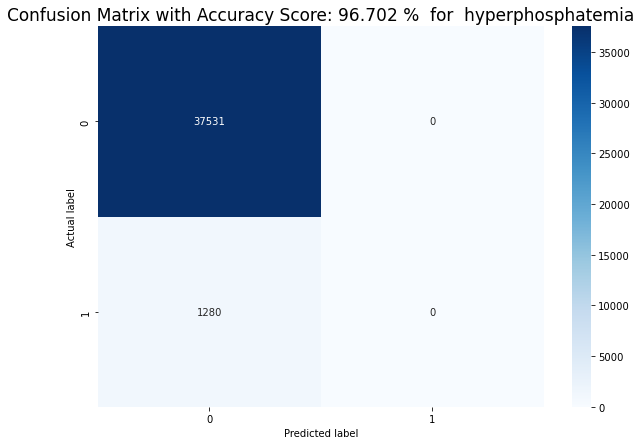

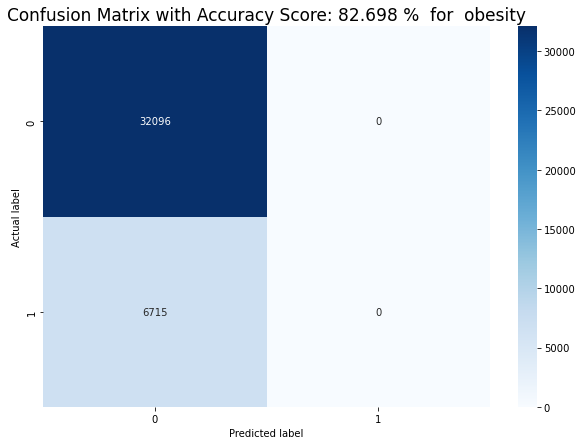

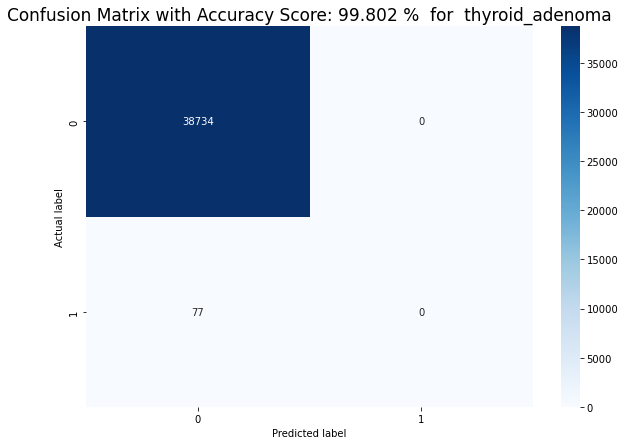

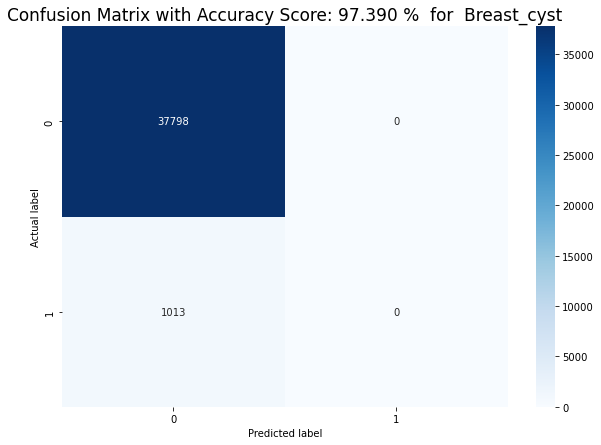

In [18]:
print('\n\nSeen Data\n')
preds_seen = (train_seen > 0.5).astype("int32")
report(Y_seen, preds_seen, list(preds_seen.columns))

print('\n\nUnSeen Data\n')
preds_unseen = (train_unseen > 0.5).astype("int32")
report(Y_unseen, preds_unseen, list(preds_unseen.columns))